In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn import metrics
from sklearn.preprocessing import PolynomialFeatures
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

# Exploratory Analysis

In [2]:
traffic_df = pd.read_csv("Metro_Interstate_Traffic_Volume.csv")

In [3]:
traffic_df.tail()

,holiday,temp,rain_1h,snow_1h,clouds_all,weather_main,weather_description,date_time,traffic_volume
48199,None,283.45,0.0,0.0,75,Clouds,broken clouds,2018-09-30 19:00:00,3543
48200,None,282.76,0.0,0.0,90,Clouds,overcast clouds,2018-09-30 20:00:00,2781
48201,None,282.73,0.0,0.0,90,Thunderstorm,proximity thunderstorm,2018-09-30 21:00:00,2159
48202,None,282.09,0.0,0.0,90,Clouds,overcast clouds,2018-09-30 22:00:00,1450
48203,None,282.12,0.0,0.0,90,Clouds,overcast clouds,2018-09-30 23:00:00,954


### Description of the column categories 
- holiday: Categorical US National holidays plus regional holiday, Minnesota State Fair
- temp: Numeric Average temp in kelvin
- rain_1h: numeric amount in mm of rain that occured in the hour
- snow_1h: numeric amount in mm of snow that occurred in the hour 
- clouds_all: numeric percentage of cloud cover
- weather_main: categorical short textual description of the current weather
- weather_description: categorical longer textual description of the current weather
- date_time: DateTime hour of the data collected in local CST Time 
- traffic_volume:  Numeric Hourly I-94 ATR 301 reported westbound traffic volume

In [4]:
# replace holiday with numeric values to represent a holiday = 1 and non-holiday = 0
traffic_df["holiday"] = traffic_df["holiday"].replace('None', 0)
traffic_df["holiday"] = traffic_df["holiday"].replace("Columbus Day", 1)
traffic_df["holiday"] = traffic_df["holiday"].replace("Veterans Day", 1)
traffic_df["holiday"] = traffic_df["holiday"].replace("Thanksgiving Day", 1)
traffic_df["holiday"] = traffic_df["holiday"].replace("Christmas Day", 1)
traffic_df["holiday"] = traffic_df["holiday"].replace("New Years Day", 1)
traffic_df["holiday"] = traffic_df["holiday"].replace("Washingtons Birthday", 1)
traffic_df["holiday"] = traffic_df["holiday"].replace("Memorial Day", 1)
traffic_df["holiday"] = traffic_df["holiday"].replace("Independence Day", 1)
traffic_df["holiday"] = traffic_df["holiday"].replace("Labor Day", 1)
traffic_df["holiday"] = traffic_df["holiday"].replace("Martin Luther King Jr Day", 1)
traffic_df["holiday"] = traffic_df["holiday"].replace("State Fair", 1)

In [5]:
traffic_df.head()

,holiday,temp,rain_1h,snow_1h,clouds_all,weather_main,weather_description,date_time,traffic_volume
0,0,288.28,0.0,0.0,40,Clouds,scattered clouds,2012-10-02 09:00:00,5545
1,0,289.36,0.0,0.0,75,Clouds,broken clouds,2012-10-02 10:00:00,4516
2,0,289.58,0.0,0.0,90,Clouds,overcast clouds,2012-10-02 11:00:00,4767
3,0,290.13,0.0,0.0,90,Clouds,overcast clouds,2012-10-02 12:00:00,5026
4,0,291.14,0.0,0.0,75,Clouds,broken clouds,2012-10-02 13:00:00,4918


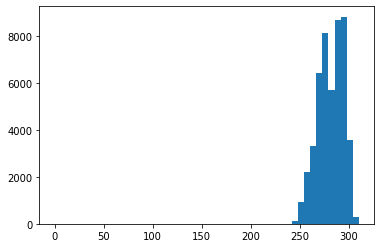

In [6]:
plt.hist(traffic_df["temp"], bins = 50)
plt.show()

In [7]:
print(traffic_df["temp"][0])

288.28


In [8]:
def to_farenheit(X): 
    F_x = X - 273.15
    F_x = ((9/5) * (F_x)) + 32.0
    
    return float(F_x)

In [9]:
# Removing 0 Kelvin values and transforming into farenheit
traffic_df = traffic_df[traffic_df['temp'] > 0]
traffic_df["temp"] = traffic_df['temp'].apply(to_farenheit)

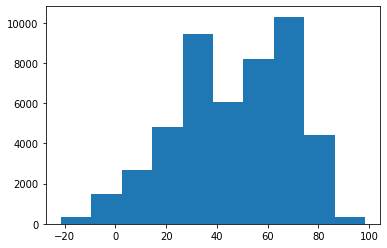

In [10]:
plt.hist(traffic_df['temp'])
plt.show()

In [11]:
traffic_df.head()

,holiday,temp,rain_1h,snow_1h,clouds_all,weather_main,weather_description,date_time,traffic_volume
0,0,59.234,0.0,0.0,40,Clouds,scattered clouds,2012-10-02 09:00:00,5545
1,0,61.178,0.0,0.0,75,Clouds,broken clouds,2012-10-02 10:00:00,4516
2,0,61.574,0.0,0.0,90,Clouds,overcast clouds,2012-10-02 11:00:00,4767
3,0,62.564,0.0,0.0,90,Clouds,overcast clouds,2012-10-02 12:00:00,5026
4,0,64.382,0.0,0.0,75,Clouds,broken clouds,2012-10-02 13:00:00,4918


Number of holiday days: 61
Number of non-holiday days: 48133


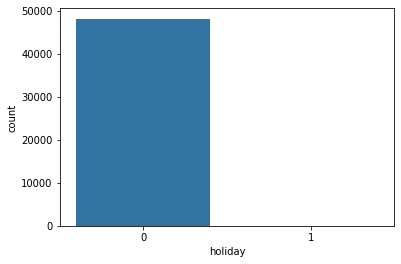

In [12]:
sns.countplot(traffic_df['holiday'])
print("Number of holiday days:", (traffic_df['holiday'] == 1).sum())
print("Number of non-holiday days:", (traffic_df['holiday'] == 0).sum())
plt.show()

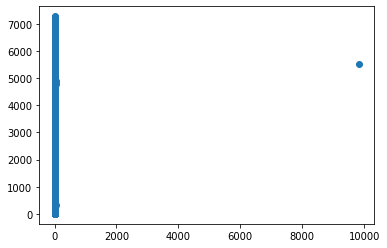

In [13]:
# Scatterplot of rain and the traffic volume
plt.scatter(traffic_df['rain_1h'], traffic_df['traffic_volume'])
plt.show()

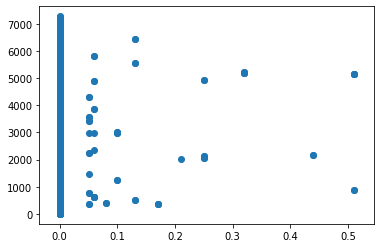

In [14]:
# Scatterplot of snow and the traffic volume
plt.scatter(traffic_df['snow_1h'], traffic_df['traffic_volume'])
plt.show()

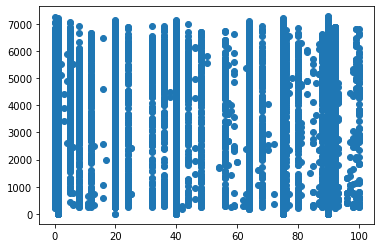

In [25]:
# Scatterplot of cloud cover percentage and the traffic volume
plt.scatter(traffic_df['clouds_all'].values, traffic_df['traffic_volume'].values)
plt.show()

In [15]:
traffic_df.corr()

,holiday,temp,rain_1h,snow_1h,clouds_all,traffic_volume
holiday,1.000000,-0.008258,-0.000216,-0.000969,-0.005620,-0.042911
temp,-0.008258,1.000000,0.009484,-0.020860,-0.112859,0.132291
rain_1h,-0.000216,0.009484,1.000000,-0.000090,0.004817,0.004713
snow_1h,-0.000969,-0.020860,-0.000090,1.000000,0.027928,0.000728
clouds_all,-0.005620,-0.112859,0.004817,0.027928,1.000000,0.066819
traffic_volume,-0.042911,0.132291,0.004713,0.000728,0.066819,1.000000


# Regression on 4 Variables

## Temperature only (1st and 2nd degree)

Training error is: 3862511.302
Testing error is: 3882009.033
Temp Model (1st order): Traffic Volume = 11.795*temp + 2712.561


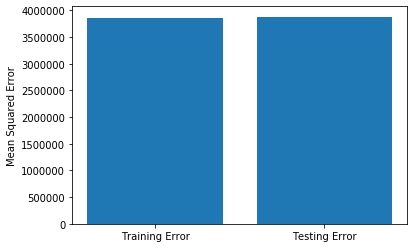

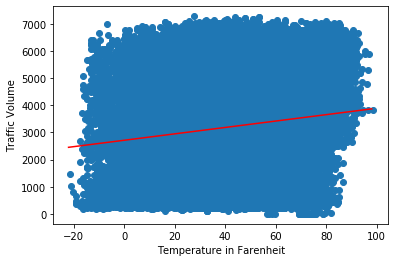

In [18]:
# Model : Temp 1st degree
X_train, X_test, Y_train, Y_test = train_test_split(traffic_df['temp'].values, traffic_df['traffic_volume'].values,
                                                    test_size = 0.2, random_state=0)
X_train = X_train.reshape(-1,1)
Y_train = Y_train.reshape(-1,1)
X_test = X_test.reshape(-1,1)
Y_test = Y_test.reshape(-1,1)

model_temp = LinearRegression().fit(X_train, Y_train)

coef = np.around(model_temp.coef_[0], 3)
intercept = np.around(model_temp.intercept_[0],3)

train_err = round(mean_squared_error(Y_train, model_temp.predict(X_train)), 3)
test_err = round(mean_squared_error(Y_test, model_temp.predict(X_test)), 3)

print("Training error is:", train_err)
print("Testing error is:", test_err)
print("Temp Model (1st degree): Traffic Volume = {}*temp + {}".format(coef[0], intercept))

# Graphing training/testing error
plt.bar(x = ["Training Error", "Testing Error"], height = [train_err, test_err])
plt.ylabel("Mean Squared Error")
plt.show()

# Graphing data and regression line
x_graph = np.linspace(round(traffic_df['temp'].min()), round(traffic_df['temp'].max()))
y_graph = coef[0] * x_graph + intercept

plt.scatter(traffic_df['temp'].values, traffic_df['traffic_volume'].values)
plt.plot(x_graph, y_graph, c='r')
plt.xlabel("Temperature in Farenheit")
plt.ylabel("Traffic Volume")
plt.show()

Training error is: 3854065.344
Testing error is: 3866498.819
Temp Model (2nd degree): Traffic Volume = -6.696*temp + 0.217*temp^2 + 2988.679


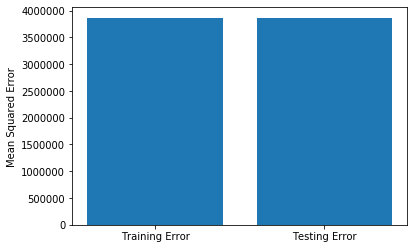

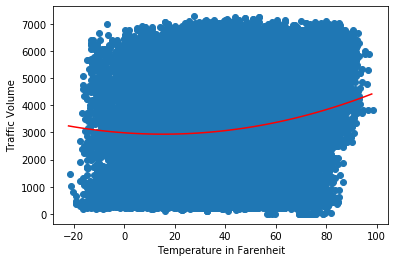

In [21]:
#Model: Temp 2nd degree
X_train, X_test, Y_train, Y_test = train_test_split(traffic_df['temp'].values, traffic_df['traffic_volume'].values,
                                                    test_size = 0.2, random_state=0)
poly = PolynomialFeatures(degree=2, include_bias=False)
X_train = poly.fit_transform(X_train.reshape(-1,1))
Y_train = Y_train.reshape(-1,1)
X_test = poly.transform(X_test.reshape(-1,1))
Y_test = Y_test.reshape(-1,1)

model_temp_2nd = LinearRegression().fit(X_train, Y_train)
coef = np.around(model_temp_2nd.coef_[0], 3)
intercept = np.around(model_temp_2nd.intercept_[0],3)

train_err = round(mean_squared_error(Y_train, model_temp_2nd.predict(X_train)), 3)
test_err = round(mean_squared_error(Y_test, model_temp_2nd.predict(X_test)), 3)

print("Training error is:", train_err)
print("Testing error is:", test_err)
print("Temp Model (2nd degree): Traffic Volume = {}*temp + {}*temp^2 + {}".format(coef[0], coef[1], intercept))

# Graphing training/testing error
plt.bar(x = ["Training Error", "Testing Error"], height = [train_err, test_err])
plt.ylabel("Mean Squared Error")
plt.show()

# Graphing data and regression line
x_graph = np.linspace(round(traffic_df['temp'].min()), round(traffic_df['temp'].max()))
y_graph = coef[0] * x_graph + coef[1] * pow(x_graph, 2) + intercept

plt.scatter(traffic_df['temp'].values, traffic_df['traffic_volume'].values)
plt.plot(x_graph, y_graph, c='r')
plt.xlabel("Temperature in Farenheit")
plt.ylabel("Traffic Volume")
plt.show()

## Rain only

Training error is: 3954345.792
Testing error is: 3917879.856
Rain Model: Traffic Volume = 0.211*rain_1h + 3262.398


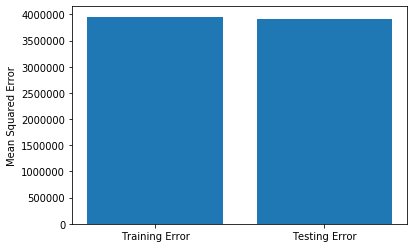

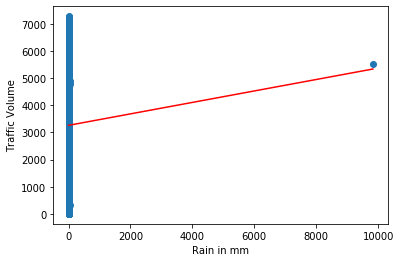

In [27]:
# Model: Rain 1st degree
X = traffic_df['rain_1h'].to_numpy()
Y = traffic_df['traffic_volume'].to_numpy()

X = X.reshape(-1, 1)
Y = Y.reshape(-1, 1)
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0)

rain_reg = LinearRegression().fit(X_train, Y_train)
coef = np.around(rain_reg.coef_[0], 3)
intercept = np.around(rain_reg.intercept_[0],3)

train_err = round(mean_squared_error(Y_train, rain_reg.predict(X_train)), 3)
test_err = round(mean_squared_error(Y_test, rain_reg.predict(X_test)), 3)

print("Training error is:", train_err)
print("Testing error is:", test_err)
print("Rain Model: Traffic Volume = {}*rain_1h + {}".format(coef[0], intercept))

# Graphing training/testing error
plt.bar(x = ["Training Error", "Testing Error"], height = [train_err, test_err])
plt.ylabel("Mean Squared Error")
plt.show()

# Graphing data and regression line
x_graph = np.linspace(round(traffic_df['rain_1h'].min()), round(traffic_df['rain_1h'].max()))
y_graph = coef[0] * x_graph + intercept

plt.scatter(traffic_df['rain_1h'].values, traffic_df['traffic_volume'].values)
plt.plot(x_graph, y_graph, c='r')
plt.xlabel("Rain in mm")
plt.ylabel("Traffic Volume")
plt.show()

## Snow only

## Clouds only

Training error is: 3894865.854
Testing error is: 3938216.747
Cloud Model: Traffic Volume = 3.266*cloud_all + 3101.356


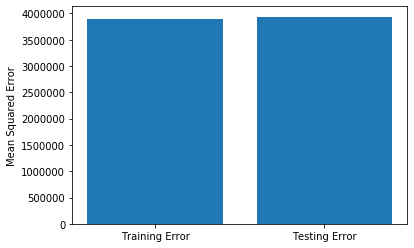

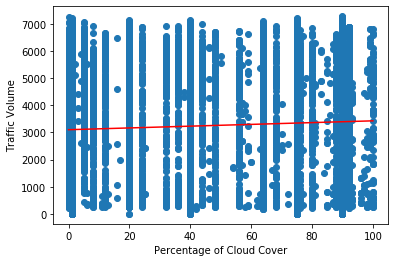

In [23]:
#Model: Clouds 1st degree
X_train, X_test, Y_train, Y_test = train_test_split(traffic_df['clouds_all'].values, traffic_df['traffic_volume'].values,
                                                    test_size = 0.2, random_state=0)
X_train = X_train.reshape(-1,1)
Y_train = Y_train.reshape(-1,1)
X_test = X_test.reshape(-1,1)
Y_test = Y_test.reshape(-1,1)

model_cloud = LinearRegression().fit(X_train, Y_train)
coef = np.around(model_cloud.coef_[0], 3)
intercept = np.around(model_cloud.intercept_[0],3)

train_err = round(mean_squared_error(Y_test, model_cloud.predict(X_test)), 3)
test_err = round(mean_squared_error(Y_train, model_cloud.predict(X_train)), 3)

print("Training error is:", train_err)
print("Testing error is:", test_err)
print("Cloud Model: Traffic Volume = {}*cloud_all + {}".format(coef[0], intercept))

# Graphing training/testing error
plt.bar(x = ["Training Error", "Testing Error"], height = [train_err, test_err])
plt.ylabel("Mean Squared Error")
plt.show()

# Graphing data and regression line
x_graph = np.linspace(round(traffic_df['clouds_all'].min()), round(traffic_df['clouds_all'].max()))
y_graph = coef[0] * x_graph + intercept

plt.scatter(traffic_df['clouds_all'].values, traffic_df['traffic_volume'].values)
plt.plot(x_graph, y_graph, c='r')
plt.xlabel("Percentage of Cloud Cover")
plt.ylabel("Traffic Volume")
plt.show()